In [58]:
from helpers.dataset import pianoroll_dataset_batch
from models import Generalist
from helpers.datapreparation import *
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
DATA_DIR = "datasets/training/piano_roll_fs5"


In [15]:
dataset = pianoroll_dataset_batch(DATA_DIR)

AttributeError: 'pianoroll_dataset_batch' object has no attribute 'shape'

In [18]:
print(f"Number of tags (composers): {dataset.num_tags()}")
print(f"Number of keys: {dataset.num_keys()}")
print(f"Size of dataset (number of examples): {len(dataset)}")

Number of tags (composers): 4
Number of keys: 128


In [22]:
# To get first note of first song of first composer:
composer_no = 0
timestep_no = 0
example_no = 0
dataset[example_no][composer_no][timestep_no]

tensor([[0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1.]])

In [14]:
# Grab first note of first song
dataset[0][0].shape

torch.Size([1128, 1, 128])

Shape of notes: torch.Size([1128, 128])


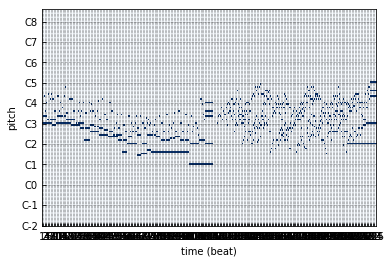

In [52]:
notes = dataset[example_no][composer_no].squeeze()
print(f"Shape of notes: {notes.shape}")
visualize_piano_roll(notes.numpy())
      
      

In [55]:
# We cam play by transposing the numpy array of the dataset, since that is what embed_play expects
embed_play_v1(notes.numpy().T, fs=5)

In [59]:

def threshold(tensor, threshold=0.5):
    """ Thresholds the tensor in order to binarize it """
    return tensor > threshold


In [63]:
class Generalist(nn.Module):
    """ The generalists composes music without learning the difference between 
        different composers using an LSTM.
    """    
    
    def __init__(self, input_size, hidden_size, num_layers):
        super(Generalist, self).__init__()
        self.input_size = input_size
        self.output_size = input_size # Since input is the same as output (we want to predict next notes)
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        self._hidden = torch.zeros(num_layers, 1, hidden_size) # (1, batch_size, hidden_size)
        self._cellstate = torch.zeros(num_layers, 1, hidden_size)
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, dropout=(0 if num_layers==1 else 0.05))
        self.hidden_to_output = nn.Linear(hidden_size, self.output_size)


    def forward(self, inputs):
        # Since this is the generalist, do not pass any category info to the module
        output, (self._hidden, self._cellstate) = self.lstm(inputs, (self._hidden, self._cellstate))
        output = self.hidden_to_output(output)
        #print(output)
        return output, self._hidden


In [ ]:
DATA_DIR = "datasets/training/piano_roll_fs5"
dataset = pianoroll_dataset_batch(DATA_DIR)


INPUT_SIZE = 128
HIDDEN_SIZE = 15
NUM_EPOCHS = len(dataset)

composer_no = 0
example_no = 0
inputs = dataset[example_no][composer_no][0:-1]
targets = dataset[example_no][composer_no][:][:][1:].float() # Shifted one note to the right

model = Generalist(INPUT_SIZE, HIDDEN_SIZE, 1)
loss_func = nn.MSELoss()
optimizer = optim.SGD(model.parameters(), lr=0.1)

NUM_EPOCHS = 100

for epoch in range(NUM_EPOCHS):
    optimizer.zero_grad() # By default, PyTorch cumulates gradients, so remove them
    # Forward
    output, _ = model(inputs)
    
    loss = loss_func(output, targets)
    loss.backward(retain_graph=(epoch != NUM_EPOCHS))
    optimizer.step()
    if epoch%10 == 0:
        print("epoch {}, loss {}".format(epoch,loss.data.numpy()))

output = output.detach().numpy().squeeze()
piano_roll = threshold(output, threshold=0.02)
#visualize_piano_roll(piano_roll)


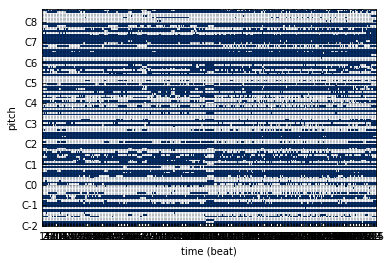

In [66]:
embed_play_v1(piano_roll.T, fs=5)